In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, OrdinalEncoder
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import make_pipeline as make_pipeline_imb

import warnings
warnings.filterwarnings('ignore')


In [20]:
# Load Dataset
df = pd.read_csv("data.csv")
df.head()


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [21]:
print("Shape of dataset:", df.shape)

Shape of dataset: (569, 33)


In [22]:
#  Check data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [5]:
# Check for missing values
df.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [23]:
df.drop(columns=['id', 'Unnamed: 32'], inplace=True)


In [24]:
df.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


### Encoding

In [25]:
df["diagnosis"] = df["diagnosis"].map({"M": 0, "B": 1})


In [26]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,0,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,0,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,0,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


### Exploratory Data Analysis

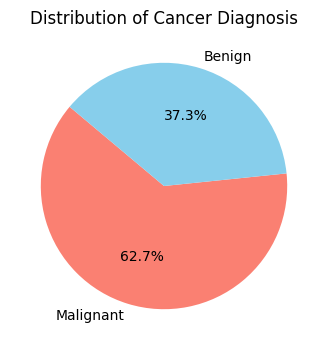

In [9]:
plt.figure(figsize=(4,4))
output_counts = df['diagnosis'].value_counts()
plt.pie(output_counts, labels=['Malignant','Benign'], autopct='%1.1f%%', startangle=140, colors=['salmon','skyblue'])
plt.title("Distribution of Cancer Diagnosis")
plt.show()


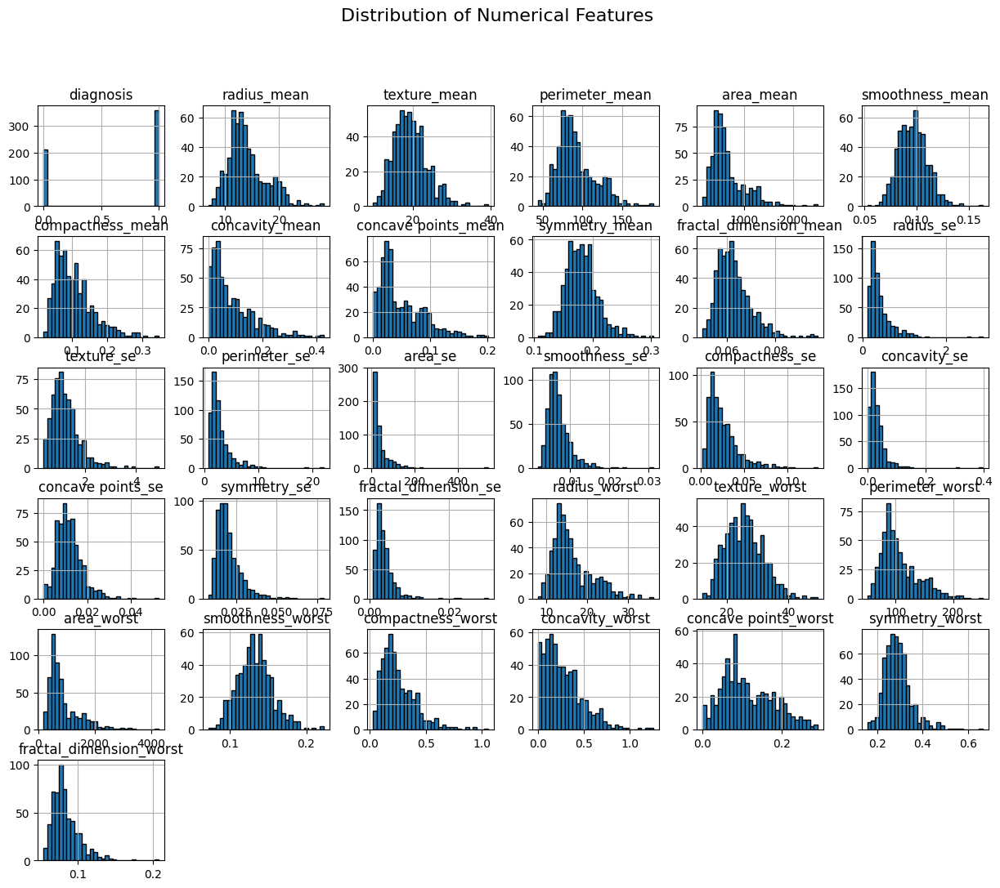

In [20]:
num_cols = df.select_dtypes(include=['int64','float64']).columns
df[num_cols].hist(figsize=(15,12), bins=30, edgecolor="black")
plt.suptitle("Distribution of Numerical Features", fontsize=16)
plt.show()


Observations from the Distributions
diagnosis
Binary (0/1).
No scaling needed — this is the target variable.
radius_mean, perimeter_mean, area_mean
Right-skewed, long tail to the right.
RobustScaler preferred (to handle skewness and outliers).
texture_mean
Roughly normal distribution.
StandardScaler works well.
smoothness_mean, symmetry_mean, fractal_dimension_mean
Fairly tight and close-to-normal distributions.
StandardScaler is appropriate.
compactness_mean, concavity_mean, concave_points_mean
Strongly right-skewed (long tails).
RobustScaler better than StandardScaler.
radius_se, perimeter_se, area_se
Heavily right-skewed, with extreme outliers.
RobustScaler recommended.
texture_se
More balanced but still slightly skewed.
StandardScaler or RobustScaler (depending on model sensitivity).
smoothness_se, symmetry_se, fractal_dimension_se
Narrow distributions around small values, light skewness.
StandardScaler works.
compactness_se, concavity_se, concave_points_se
Strong right-skewness with heavy tails.
RobustScaler best.
radius_worst, perimeter_worst, area_worst
Right-skewed, similar to their "mean" counterparts.
RobustScaler recommended.
texture_worst
Roughly normal.
StandardScaler fits well.
smoothness_worst, symmetry_worst, fractal_dimension_worst
Nearly normal, compact distributions.
StandardScaler is appropriate.
compactness_worst, concavity_worst, concave_points_worst
Right-skewed with heavy tails.
RobustScaler recommended.

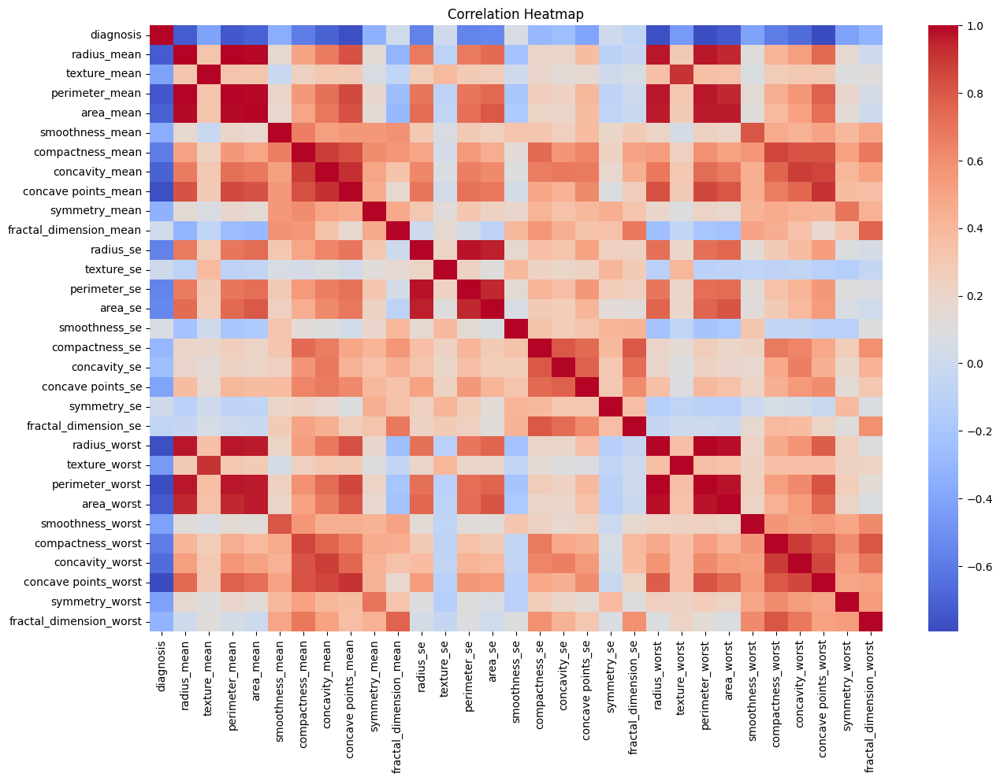

In [12]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr(), cmap="coolwarm", annot=False)
plt.title("Correlation Heatmap")
plt.show()


In [ ]:
# List of highly correlated features to drop (keeping only one from each group)
drop_cols = ['perimeter', 'area', 'concavity', 'concave points']  # keep 'radius' and 'compactness'

# Drop the columns from the dataframe
df_reduced = df.drop(columns=drop_cols)

# Check remaining columns
print(df_reduced.columns)


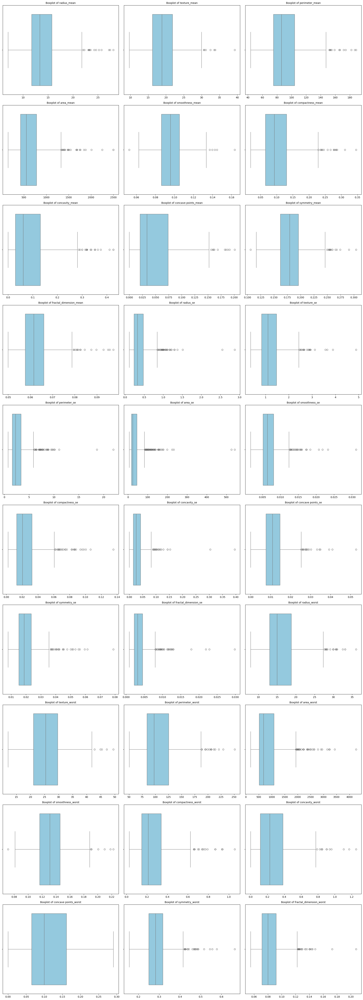

In [22]:
def plot_boxplots(df, exclude_cols=None):
    """
    Plots boxplots for all numeric features in the dataframe.
    
    Parameters:
        df (pd.DataFrame): dataset
        exclude_cols (list): optional list of columns to exclude (e.g., target column)
    """
    # Select numeric columns
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    
    # Remove excluded columns if provided
    if exclude_cols:
        num_cols = [col for col in num_cols if col not in exclude_cols]
    
    # Plot boxplots
    plt.figure(figsize=(20, len(num_cols) * 2))
    for i, col in enumerate(num_cols, 1):
        plt.subplot(len(num_cols)//3 + 1, 3, i)  # 3 plots per row
        sns.boxplot(x=df[col], color='skyblue')
        plt.title(f"Boxplot of {col}", fontsize=10)
        plt.xlabel("")
    plt.tight_layout()
    plt.show()

# Example usage:
plot_boxplots(df, exclude_cols=['diagnosis'])


In [11]:
# Select only numerical columns (exclude target)
num_cols = df.drop(columns=['diagnosis']).select_dtypes(include=['float64', 'int64']).columns.tolist()

# Pairplot with different colors based on target (diagnosis)
sns.pairplot(
    df[num_cols + ['diagnosis']], 
    hue="diagnosis", 
    diag_kind="kde", 
    palette={0: "salmon", 1: "skyblue"}
)

plt.suptitle("Pairplot of Numerical Variables by Diagnosis", y=1.02) 
plt.show()


Top features for pairplot: ['concave points_worst', 'perimeter_worst', 'concave points_mean', 'radius_worst', 'perimeter_mean']


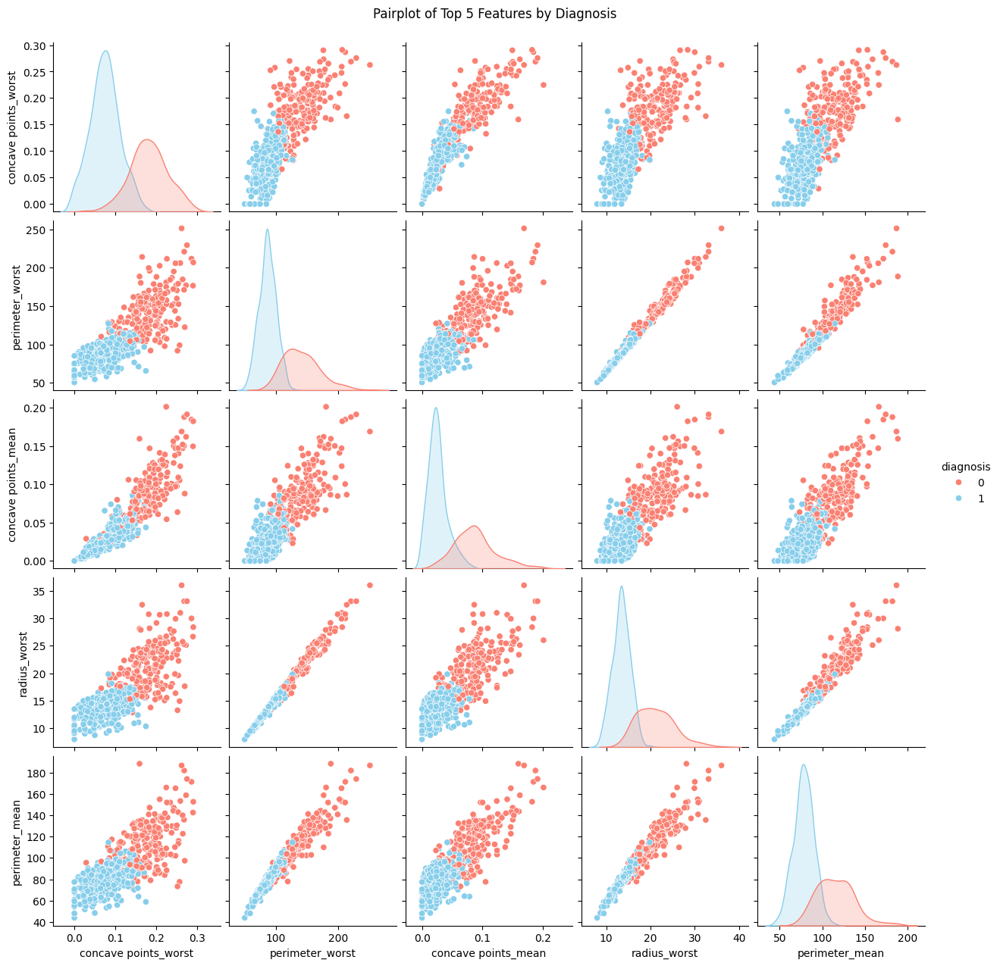

In [18]:
# Select top 5 features most correlated with diagnosis
corr_target = df.corr()['diagnosis'].abs().sort_values(ascending=False)
top_features = corr_target.index[1:6]  # exclude 'diagnosis' itself

print("Top features for pairplot:", top_features.tolist())

# Pairplot only for these features
sns.pairplot(
    df[top_features.tolist() + ['diagnosis']], 
    hue="diagnosis", 
    diag_kind="kde", 
    palette={0: "salmon", 1: "skyblue"}
)

plt.suptitle("Pairplot of Top 5 Features by Diagnosis", y=1.02)
plt.show()


In [13]:
# Step 1: Compute absolute correlation matrix
corr_matrix = df.corr().abs()

# Step 2: Keep upper triangle of the correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# Step 3: Identify columns with correlation > 0.9
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]
print("Dropping these highly correlated features:", to_drop)

# Step 4: Drop them from the dataset
df_reduced = df.drop(columns=to_drop)

print("Shape before:", df.shape)
print("Shape after:", df_reduced.shape)


Dropping these highly correlated features: ['perimeter_mean', 'area_mean', 'concave points_mean', 'perimeter_se', 'area_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'concave points_worst']
Shape before: (569, 31)
Shape after: (569, 21)


### Feature Scaling

In [31]:
from scipy.stats import skew

# Copy dataset (without target)
features = df.drop(columns=['diagnosis'], errors='ignore')

# Detect skewness
skewness = features.apply(lambda x: skew(x.dropna()))

# Auto-assign groups
normal_features = skewness[abs(skewness) < 0.5].index.tolist()
skewed_features = skewness[abs(skewness) >= 0.5].index.tolist()
bounded_features = [col for col in features.columns if features[col].between(0, 1).all()]

# Remove overlaps
normal_features = list(set(normal_features) - set(bounded_features))
skewed_features = list(set(skewed_features) - set(bounded_features))



print("Normal features:", normal_features[:5], "...")
print("Bounded features:", bounded_features)
print("Skewed features:", skewed_features[:5], "...")


Normal features: ['texture_worst'] ...
Bounded features: ['smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'smoothness_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']
Skewed features: ['perimeter_se', 'area_mean', 'texture_se', 'compactness_worst', 'radius_mean'] ...


In [32]:
preprocessor = ColumnTransformer(transformers=[
    ("normal", StandardScaler(), normal_features),
    ("bounded", MinMaxScaler(), bounded_features),
    ("skewed", RobustScaler(), skewed_features)
], remainder="passthrough")

# Pipeline with Logistic Regression
pipeline = Pipeline([
    ("preprocessor", preprocessor),
    ("model", LogisticRegression(max_iter=500, solver="lbfgs"))
])

### Train-test split

In [15]:
X = df.drop(columns=['diagnosis'])
y = df['diagnosis']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42, stratify=y
)

print("Training shape:", X_train.shape)
print("Test shape:", X_test.shape)


Training shape: (398, 30)
Test shape: (171, 30)


### Model Training

In [ ]:

# Step 6: Handle imbalance + Define models


# SMOTE for oversampling minority class
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import make_pipeline as make_pipeline_imb

# scale_pos_weight for XGBoost
scale_pos_weight = (len(y_train) - sum(y_train)) / sum(y_train)

# Define models
models = {
    "Logistic Regression": LogisticRegression(random_state=42, class_weight="balanced"),
    "Random Forest": RandomForestClassifier(random_state=42, class_weight="balanced"),
    "K-Nearest Neighbors": make_pipeline_imb(SMOTE(random_state=42), KNeighborsClassifier()),
    "Support Vector Machine": make_pipeline_imb(SMOTE(random_state=42), SVC(probability=True, random_state=42)),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric="logloss", 
                             scale_pos_weight=scale_pos_weight, random_state=42),
    "Gradient Boosting": make_pipeline_imb(SMOTE(random_state=42), GradientBoostingClassifier(random_state=42))
}


In [ ]:

# Step 7: Train models

trained_models = {}

for name, model in models.items():
    print(f"Training {name}...")
    model.fit(X_train, y_train)  # Fit each model on training data
    trained_models[name] = model


Training Logistic Regression...
Training Random Forest...
Training K-Nearest Neighbors...
Training Support Vector Machine...
Training XGBoost...
Training Gradient Boosting...


### Model Evaluation

In [ ]:

# Step 8: Model Evaluation

results = {}

for name, model in trained_models.items():
    print(f"\nEvaluating {name}...")
    
    # Predictions
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    # Training metrics
    train_accuracy = accuracy_score(y_train, y_train_pred)
    train_precision = precision_score(y_train, y_train_pred)
    train_recall = recall_score(y_train, y_train_pred)
    train_f1 = f1_score(y_train, y_train_pred)
    
    # Testing metrics
    test_accuracy = accuracy_score(y_test, y_test_pred)
    test_precision = precision_score(y_test, y_test_pred)
    test_recall = recall_score(y_test, y_test_pred)
    test_f1 = f1_score(y_test, y_test_pred)
    
    # Store results
    results[name] = {
        "Train Accuracy": train_accuracy,
        "Train Precision": train_precision,
        "Train Recall": train_recall,
        "Train F1": train_f1,
        "Test Accuracy": test_accuracy,
        "Test Precision": test_precision,
        "Test Recall": test_recall,
        "Test F1": test_f1
    }

# Convert results into a DataFrame for better visualization
results_df = pd.DataFrame(results).T
display(results_df)



Evaluating Logistic Regression...

Evaluating Random Forest...

Evaluating K-Nearest Neighbors...

Evaluating Support Vector Machine...

Evaluating XGBoost...

Evaluating Gradient Boosting...


,Train Accuracy,Train Precision,Train Recall,Train F1,Test Accuracy,Test Precision,Test Recall,Test F1
Logistic Regression,0.957286,0.975510,0.956,0.965657,0.947368,0.937500,0.981308,0.958904
Random Forest,1.000000,1.000000,1.000,1.000000,0.941520,0.944954,0.962617,0.953704
K-Nearest Neighbors,0.949749,0.960000,0.960,0.960000,0.912281,0.933962,0.925234,0.929577
Support Vector Machine,0.917085,0.928854,0.940,0.934394,0.888889,0.907407,0.915888,0.911628
XGBoost,1.000000,1.000000,1.000,1.000000,0.947368,0.945455,0.971963,0.958525
Gradient Boosting,1.000000,1.000000,1.000,1.000000,0.964912,0.963303,0.981308,0.972222


### Model-by-Model Analysis
1. Logistic Regression

Train Accuracy: 0.957 | Test Accuracy: 0.947 → small gap, good generalization.

Recall (Test): 0.981 → excellent at catching cancer cases.

F1 (Test): 0.959 → balanced precision and recall.
 Conclusion: Strong baseline model, interpretable, and generalizes well.

2. Random Forest

Train Accuracy: 1.000 | Test Accuracy: 0.942 → clear overfitting.

Precision & Recall (Test): High (0.945 & 0.963) → still strong despite overfitting.

F1 (Test): 0.954 → good, but stability is a concern.
Conclusion: Very powerful but overfits. Needs tuning (e.g., fewer trees, limit depth).

3. K-Nearest Neighbors (KNN)

Train Accuracy: 0.950 | Test Accuracy: 0.912 → noticeable drop.

Recall (Test): 0.925 → good, but worse than Logistic Regression or Gradient Boosting.

F1 (Test): 0.930 → consistent but weaker.
 Conclusion: Decent model but less robust. Sensitive to parameter k and scaling.

4. Support Vector Machine (SVM)

Train Accuracy: 0.917 | Test Accuracy: 0.889 → underfitting (both are lower).

Recall (Test): 0.916 → not bad, but lower than others.

F1 (Test): 0.912 → stable but weaker overall.
 Conclusion: Lags behind other models. Needs hyperparameter tuning (kernel, C, gamma).

5. XGBoost

Train Accuracy: 1.000 | Test Accuracy: 0.947 → again overfitting (perfect train, drop in test).

Recall (Test): 0.972 → excellent detection of positives.

F1 (Test): 0.959 → very strong.
 Conclusion: Powerful like Random Forest but slightly better recall. Still overfits → tune learning rate & depth.

6. Gradient Boosting

Train Accuracy: 1.000 | Test Accuracy: 0.965 → best generalization despite perfect train.

Recall (Test): 0.981 → highest, excellent for medical use (catching all positives).

F1 (Test): 0.972 → the top performer.
 Conclusion: Best overall model. Strong precision, recall, and generalization.

 Final Summary

Best Model:  Gradient Boosting (highest test accuracy, recall, and F1)

Strong Alternatives: Logistic Regression (stable, interpretable), XGBoost (high recall but overfitting)

Overfit Models: Random Forest, XGBoost (train = 1.0, test lower)

Weaker Model: SVM (lower accuracy and recall compared to others)

 For breast cancer detection (where recall is critical), Gradient Boosting is the winner, followed closely by Logistic Regression (if interpretability is important).